## ☀️: Ploty

In [1]:
# Import Libraries
import plotly.express as px 
import plotly.graph_objects as go
import plotly.io as pio
import plotly.figure_factory as ff
import plotly.offline as pyo
from plotly.subplots import make_subplots
import plotly.colors as pc

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
import warnings

warnings.warn("This is a warning message")

C:\Users\iamus\AppData\Local\Temp\ipykernel_3700\3731920106.py:3: UserWarning:

This is a warning message



In [3]:
import warnings

warnings.filterwarnings("ignore")

In [6]:
# Diamonds dataset (raw CSV link from seaborn-data GitHub)
import pandas as pd

url = "https://raw.githubusercontent.com/mwaskom/seaborn-data/master/diamonds.csv"
df = pd.read_csv(url)

# Shuffle rows
df = df.sample(frac=1, random_state=10)

df.head()


,carat,cut,color,clarity,depth,table,price,x,y,z
8018,1.01,Premium,E,SI1,61.7,56.0,4330,6.44,6.39,3.96
1583,0.70,Very Good,D,VS1,60.4,58.0,3008,5.71,5.78,3.47
9138,1.13,Very Good,H,SI2,59.8,59.0,4537,6.75,6.82,4.06
2787,0.76,Ideal,F,VS2,61.0,55.0,3257,5.89,5.92,3.60
52429,0.70,Premium,I,VVS1,61.2,59.0,2513,5.65,5.69,3.47


## ☀️: Reindex

In [7]:
df = df.sample(frac=1, random_state=10).reset_index(drop=True)
df = df.reindex(range(len(df)))
print(df)

       carat        cut color clarity  depth  table  price     x     y     z
0       0.25  Very Good     D    VVS2   64.2   55.0    512  3.98  4.00  2.56
1       0.71      Ideal     I     VS1   62.2   54.0   2557  5.71  5.75  3.56
2       0.36       Good     F     VS1   63.6   60.0    945  4.52  4.47  2.86
3       0.70  Very Good     E     SI1   61.7   62.0   2569  5.64  5.68  3.49
4       0.42      Ideal     G      IF   62.4   57.0   1394  4.79  4.82  3.00
...      ...        ...   ...     ...    ...    ...    ...   ...   ...   ...
53935   1.56  Very Good     I     VS1   62.7   58.0   9857  7.42  7.37  4.64
53936   0.30    Premium     D     VS2   60.4   59.0    911  4.35  4.32  2.62
53937   0.45      Ideal     E     SI2   61.5   55.0    706  4.92  4.97  3.04
53938   0.71    Premium     I     VS1   61.8   58.0   2327  5.76  5.72  3.55
53939   0.79    Premium     D     SI1   61.4   59.0   3058  5.96  5.89  3.64

[53940 rows x 10 columns]


## ☀️: Scatter Plot

In [15]:
fig = px.scatter(df, x="carat", y="price", color="cut",
                 title="Diamonds Dataset",
                 labels= {'carat':"Carat Weight","price": "Price ($)"}
                 )
fig.show()

In [10]:
import plotly.express as px

fig = px.scatter(
    df,
    x="carat",
    y="price",
    color="cut",
    size="price",                 # Bubble size adds info density
    hover_data={
        "price": ":,.0f",          # Price formatting
        "carat": True,
        "cut": True,
        "color": True,
        "clarity": True
    },
    facet_col="cut",               # Compare distributions by cut
    trendline="ols",               # Regression line
    opacity=0.6,
    log_y=True,                    # Handle skewed price
    title="💎 Diamonds: Carat vs Price by Cut"
)

fig.update_layout(
    template="plotly_dark",
    title_x=0.5,
    legend_title_text="Diamond Cut",
    height=600
)

fig.update_traces(
    marker=dict(line=dict(width=0.5))
)

fig.show()


## ☀️: Line Plot

In [11]:
fig = px.line(df, x="carat", y="price", color="cut", title="Diamonds Dataset")
fig.show()

In [13]:
import plotly.express as px

df_agg = (
    df.groupby(["cut", "carat"], as_index=False)
      .price.mean()
)


In [14]:
fig = px.line(
    df_agg,
    x="carat",
    y="price",
    color="cut",
    markers=True,
    line_shape="spline",
    title="💎 Average Diamond Price vs Carat by Cut"
)

fig.update_layout(
    template="plotly_dark",
    title_x=0.5,
    xaxis_title="Carat",
    yaxis_title="Average Price (USD)",
    legend_title_text="Diamond Cut",
    hovermode="x unified"
)

fig.show()


# ☀️: Average

In [16]:
df_mean = (
    df.groupby("carat") ["price"].mean().reset_index()
)
df_mean.head()

,carat,price
0,0.20,365.166667
1,0.21,380.222222
2,0.22,391.400000
3,0.23,486.143345
4,0.24,505.185039


In [18]:
fig = px.line(df_mean, x="carat", y="price", 
              title="Diamonds Dataset",
              labels= {'carat':"Carat Weight","price": "Price ($)"}
              )
fig.show()

## ☀️: Bar Plot

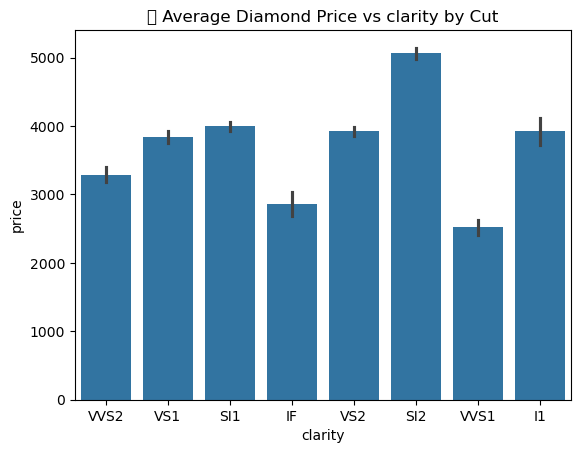

In [24]:
sns.barplot(x="clarity", y="price", data=df)
plt.title("💎 Average Diamond Price vs clarity by Cut")
plt.show()

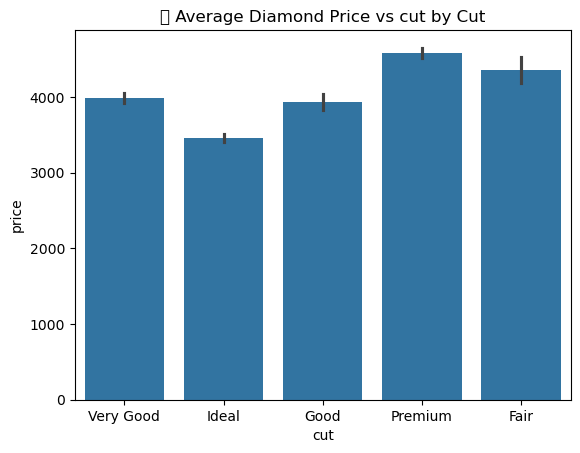

In [26]:
sns.barplot(x="cut", y="price", data=df)
plt.title("💎 Average Diamond Price vs cut by Cut")
plt.show()

In [29]:
fig = px.bar(df, x= "cut", y="price", color="cut",
             title="💎 Average Diamond Price vs cut by Cut"
             )
fig.show()

In [28]:
fig = px.bar(df, x="clarity", y="price", color="cut",
             title="💎 Average Diamond Price vs clarity by Cut"
             )
fig.show()

In [31]:
df_stats = (
    df.groupby("cut")["price"]
      .agg(["mean", "std"])
      .reset_index()
)

df_stats.head()


,cut,mean,std
0,Fair,4358.757764,3560.386612
1,Good,3928.864452,3681.589584
2,Ideal,3457.541970,3808.401172
3,Premium,4584.257704,4349.204961
4,Very Good,3981.759891,3935.862161


In [34]:
fig = px.bar(df_stats,
             x="cut",
             y="mean",
             title="Average Price & Cut:",
             color= "cut")
fig.show()

In [35]:
fig = px.bar(df_stats,
             x="cut",
             y="mean",
             error_y="std",
             title="Average Price & Cut:",
             color= "cut")
fig.show() 

In [36]:
df_stats = (
    df.groupby("clarity")["price"]
      .agg(["mean", "std"])
      .reset_index()
)

df_stats.head()
fig = px.bar(df_stats,
             x="clarity",
             y="mean",
             error_y="std",
             title="Average Price & clarity:",
             color= "clarity")
fig.show() 

# ☀️: Histogram

In [39]:
fig = px.histogram(
    df,
    x="price",
    nbins=50,
    title="Price Distribution"
)

fig.show()


In [41]:
fig = px.histogram(
    df,
    x="price",
    nbins=50,
    title="Price Distribution",
    color="cut"
)

fig.show()


In [40]:
import plotly.express as px

fig = px.histogram(
    df,
    x="price",
    nbins=50,
    color="cut",                  # Distribution by category
    marginal="box",               # Boxplot on top
    opacity=0.7,
    log_x=True,                   # Handle heavy skew
    title="💎 Diamond Price Distribution by Cut"
)

fig.update_layout(
    template="plotly_dark",
    title_x=0.5,
    xaxis_title="Price (USD, log scale)",
    yaxis_title="Count",
    bargap=0.05
)

fig.show()


# ☀️: Density Plot

In [45]:
fig = px.density_contour(
    df,x="carat",y="price",
    title="Density Counter plot"
)
fig.show()

In [51]:
import plotly.express as px

fig = px.density_contour(
    df,
    x="carat",
    y="price",
    nbinsx=50,
    nbinsy=50,
    color="cut",  # optional: color by a category
    template="plotly_dark",
)

# Layout tweaks
fig.update_layout(
    title="Carat vs Price Density Contour",
    title_x=0.5,
    xaxis_title="Carat",
    yaxis_title="Price (USD, log scale)",
)

fig.update_yaxes(type="log")  # optional for skewed price

fig.show()


In [52]:
import plotly.graph_objects as go
import numpy as np

# Example: create 2D histogram for density
x = df["carat"]
y = df["price"]

fig = go.Figure(go.Contour(
    z=np.histogram2d(x, y, bins=50)[0],
    x=np.linspace(x.min(), x.max(), 50),
    y=np.linspace(y.min(), y.max(), 50),
    colorscale="Viridis",
    contours=dict(coloring="fill", showlabels=True),
    line_smoothing=0.85
))

fig.update_layout(
    title="Carat vs Price Contour",
    template="plotly_dark",
    xaxis_title="Carat",
    yaxis_title="Price (USD, log scale)"
)

fig.update_yaxes(type="log")
fig.show()


## ☀️: Box Plot

In [46]:
fig = px.box(df, x="cut", y="price", color="cut",
             title="💎 Diamond Price Distribution by Cut"
             )
fig.show()

In [ ]:
fig = px.box(df, x="cut", y="price", color="cut",
             points="all", # optional: "outliers", "suspectedoutilers",
             title="💎 Diamond Price Distribution by Cut"
             )
fig.show()

In [59]:
fig = px.box(df, x="cut", y="price", color="clarity",
             points="all", # optional: "outliers", "suspectedoutilers",
             title="💎 Diamond Price Distribution by Cut",
             labels= {'cut':"Cut","price": "Price ($)"}
             )
fig.show()

In [53]:
import plotly.express as px

fig = px.box(
    df,
    x="cut",
    y="price",
    color="cut",                  # Color by cut
    points="all",                 # Show all points (jittered)
    notched=True,                 # Notched box shows confidence interval around median
    title="💎 Diamond Price Distribution by Cut with Outliers",
    hover_data=["carat", "color", "clarity"],  # Extra info on hover
)

fig.update_layout(
    template="plotly_dark",       # Dark theme for Kaggle notebooks
    title_x=0.5,                  # Center title
    yaxis_title="Price (USD, log scale)",
    xaxis_title="Cut",
    boxmode="group",              # Grouped boxes for multiple categories
)

fig.update_yaxes(type="log")      # Handle right-skewed prices
fig.update_traces(marker=dict(size=3, opacity=0.6))  # Smaller markers for clarity

fig.show()


In [54]:
fig = px.box(
    df,
    x="cut",
    y="price",
    color="color",       # Instead of cut, try diamond color
    points="all",
    log_y=True,
    hover_data=["carat", "clarity"]
)
fig.show()


## ☀️: Violin Plot

In [62]:
fig = px.violin(df, x="cut", y="price", color="cut",
                title="💎 Diamond Price Distribution by Cut",
                labels= {'cut':"Cut","price": "Price ($)"}
                )
plt.show()

In [63]:
import plotly.express as px

fig = px.violin(
    df,
    x="cut",
    y="price",
    color="cut",
    box=True,                     # Show box inside violin
    points="all",                 # Show all data points
    hover_data=["carat", "color", "clarity"],  # Extra info on hover
    title="💎 Diamond Price Distribution by Cut (Violin Plot)",
    labels={"cut": "Cut", "price": "Price ($)"}
)

fig.update_layout(
    template="plotly_dark",
    title_x=0.5,
    yaxis_title="Price (USD, log scale)",
    xaxis_title="Cut",
    violingap=0.2
)

fig.update_yaxes(type="log")      # Handle right-skewed price
fig.show()                         # Plotly does not use plt.show()


## ☀️: Facet Scatter

In [66]:
fig = px.scatter(df, x="carat", y="price", color="cut",
                 facet_col="cut", 
                #  facet_col_wrap=1,
                 title="Diamonds Dataset",
                 labels= {'carat':"Carat Weight","price": "Price ($)"}
                 )
fig.show()

In [67]:
fig = px.scatter(df, x="carat", y="price", color="cut",
                 facet_col="cut", 
                 facet_col_wrap=3,
                 title="Diamonds Dataset",
                 labels= {'carat':"Carat Weight","price": "Price ($)"}
                 )
fig.show()

In [75]:
fig = px.scatter(df, x="carat", y="price", color="cut",
                 facet_col="cut", 
                 size="depth",
                 title="Diamonds Dataset",
                 animation_frame="cut",
                 labels= {'carat':"Carat Weight","price": "Price ($)"}
                 )
fig.show()

In [73]:
fig = px.scatter(
    df,
    x="carat",
    y="price",
    color="cut",
    size="depth",
    animation_frame="color",   # categorical variable for frames
    title="Diamonds Dataset Animation",
    labels={'carat': "Carat Weight", "price": "Price ($)"}
)

fig.show()

In [74]:
fig = px.scatter(
    df,
    x="carat",
    y="price",
    color="cut",
    size="price",
    animation_frame="color",   # categorical variable for frames
    title="Diamonds Dataset Animation",
    labels={'carat': "Carat Weight", "price": "Price ($)"}
)

fig.show()

In [70]:
import plotly.express as px

fig = px.scatter(
    df,
    x="carat",
    y="price",
    color="cut",
    facet_col="cut",             # Facet by cut
    facet_col_wrap=3,            # Wrap facets in 3 columns
    hover_data=["color", "clarity", "depth"],  # Extra info
    opacity=0.6,                 # Reduce overplotting
    title="💎 Diamond Price vs Carat by Cut",
    labels={'carat': "Carat Weight", "price": "Price ($)"}
)

# Optional: Add log scaling for skewed price
fig.update_yaxes(type="log")

# Layout and styling
fig.update_layout(
    template="plotly_dark",
    title_x=0.5,
    height=600,
    legend_title_text="Diamond Cut"
)

fig.update_traces(marker=dict(size=5, line=dict(width=0.5, color="white")))

fig.show()


## ☀️: Heatmap

In [78]:
fig = px.density_heatmap(df, x="carat", y="price"
                         , marginal_x="histogram"
                         , marginal_y="histogram")
fig.show()

In [80]:
import plotly.express as px

fig = px.density_heatmap(
    df,
    x="carat",
    y="price",
    nbinsx=50,
    nbinsy=50,
    color_continuous_scale="Viridis",
    title="💎 Diamond Price vs Carat Density Heatmap",
    labels={"carat": "Carat Weight", "price": "Price ($)"}
)

fig.update_yaxes(type="log")  # Handle skewed price
fig.update_layout(template="plotly_dark", title_x=0.5)
fig.show()


In [81]:
fig = px.density_contour(
    df,
    x="carat",
    y="price",
    marginal_x="histogram",
    marginal_y="histogram",
    color="cut",
    title="💎 Diamond Price vs Carat Density with Marginals",
    labels={"carat": "Carat Weight", "price": "Price ($)"}
)

fig.update_yaxes(type="log")
fig.update_layout(template="plotly_dark", title_x=0.5)
fig.show()


## ☀️: SubPlots

In [82]:
from plotly.subplots import make_subplots

fig = make_subplots(rows=1, cols=2,subplot_titles=("Price vs Carat", "Price vs Depth"))

scatter = px.scatter(df, x="carat", y="price", color="cut").data[0]
fig.add_trace(scatter, row=1, col=1)

heatmap = px.density_heatmap(df, x="carat", y="price", marginal_x="histogram", marginal_y="histogram").data[0]
fig.add_trace(heatmap, row=1, col=2)

fig.update_layout(height=400, width=800, title_text="Diamonds Dataset Subplots", showlegend=False)
fig.show()

In [83]:
from plotly.subplots import make_subplots
import plotly.express as px

# Create subplot structure: 1 row, 2 columns
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=("Price vs Carat (Scatter)", "Price vs Carat Density Heatmap"),
    horizontal_spacing=0.1
)

# --- Scatter plot ---
scatter_fig = px.scatter(
    df.sample(5000, random_state=42),  # sample to avoid heavy rendering
    x="carat",
    y="price",
    color="cut",
    opacity=0.6
)

for trace in scatter_fig.data:
    fig.add_trace(trace, row=1, col=1)

# --- Density heatmap (without marginals for subplots) ---
heatmap_fig = px.density_heatmap(
    df.sample(5000, random_state=42),
    x="carat",
    y="price",
    nbinsx=50,
    nbinsy=50,
    color_continuous_scale="Viridis"
)

for trace in heatmap_fig.data:
    fig.add_trace(trace, row=1, col=2)

# Layout adjustments
fig.update_layout(
    height=500,
    width=1000,
    title_text="💎 Diamonds Dataset Subplots",
    template="plotly_dark",
    title_x=0.5
)

# Log scale for price axis in both plots
fig.update_yaxes(type="log", row=1, col=1)
fig.update_yaxes(type="log", row=1, col=2)

fig.show()


# ☀️: Heatmap(Numerical).corr()

In [85]:
corr = df[["carat","price","depth","table","x","y","z"]].corr()
fig = px.density_heatmap(corr,title="correlation numerical dataset")
fig.show()

In [89]:
corr = df[["carat","price","depth","table","x","y","z"]].corr()
corr

,carat,price,depth,table,x,y,z
carat,1.000000,0.921591,0.028224,0.181618,0.975094,0.951722,0.953387
price,0.921591,1.000000,-0.010647,0.127134,0.884435,0.865421,0.861249
depth,0.028224,-0.010647,1.000000,-0.295779,-0.025289,-0.029341,0.094924
table,0.181618,0.127134,-0.295779,1.000000,0.195344,0.183760,0.150929
x,0.975094,0.884435,-0.025289,0.195344,1.000000,0.974701,0.970772
y,0.951722,0.865421,-0.029341,0.183760,0.974701,1.000000,0.952006
z,0.953387,0.861249,0.094924,0.150929,0.970772,0.952006,1.000000


In [ ]:
corr = df[["carat","price","depth","table","x","y","z"]].corr()
fig = go. Figure(go.Heatmap(
    z=corr.values,
    x=corr.index.values,
    y=corr.columns.values,
    colorscale="Viridis", # optional: "Plasma", "Viridis", "Cividis"
    zmin=-1, zmax=1, # optional: standard correlation range
    showscale=True
    # text_auto=True,
    # text=corr.round(2).values
))
fig.show()

In [86]:
import plotly.graph_objects as go

# Compute correlation
corr = df[["carat","price","depth","table","x","y","z"]].corr()

# Create heatmap
fig = go.Figure(
    go.Heatmap(
        z=corr.values,
        x=corr.columns,
        y=corr.index,
        colorscale="Viridis",
        zmin=-1, zmax=1,         # Standard correlation range
        colorbar=dict(title="Correlation"),
        hovertemplate='X: %{x}<br>Y: %{y}<br>Correlation: %{z:.2f}<extra></extra>'
    )
)

# Add annotations (optional, shows correlation values on cells)
for i in range(len(corr)):
    for j in range(len(corr)):
        fig.add_annotation(
            x=corr.columns[j],
            y=corr.index[i],
            text=f"{corr.values[i, j]:.2f}",
            showarrow=False,
            font=dict(color="white" if abs(corr.values[i,j])>0.5 else "black")
        )

# Layout
fig.update_layout(
    title="💎 Diamonds Dataset Correlation Heatmap",
    template="plotly_dark",
    xaxis_side="top",
    height=500,
    width=600
)

fig.show()
